# Stochastic Simulation for the Reputation Score

Reference: https://hackmd.io/8CSLDfKNSAyyl-OfEzOdDQ

## Depedences

In [2]:
import scipy.stats as st
from dataclasses import dataclass
import seaborn as sns
import plotly.express as px
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import rankdata
from tqdm.auto import tqdm
from copy import deepcopy
import xarray as xr
import pandas as pd

## Definitions

In [3]:
from regex import R


Filecoin = float
Days = float


@dataclass
class Deal():
    """
    State container for Deals.
    """

    payment: Filecoin
    collateral: Filecoin
    duration: Days
    start: Days
    finished: bool = False
    slashed: bool = False
    is_early: bool = False

    @property
    def F(self):
        return 1.0 if self.finished else 0.0

    def payoff_1(self,
                 slash_penalty: float) -> float:
        """
        Deal Payoff associated with the "Skin in the Game" reputation.
        """
        payoff = self.duration
        
        if self.slashed:
            payoff *= slash_penalty
        else:
            payoff *= self.collateral
            # Active deals only
            payoff *= 1.0 if self.finished else 0.1
        return payoff

    def payoff_2(self,
                 slash_penalty: float,
                 early_multiplier: float) -> float:
        """
        Deal Payoff associated with the Capacity reputation.
        """
        payoff = self.duration
        if self.slashed:
            payoff *= slash_penalty
        else:
            payoff *= self.collateral
            # Finished deals only
            payoff *= 1.0 if self.finished else 0.0
            payoff /= self.payment
            payoff += early_multiplier if self.is_early else 0.0

        return payoff


@dataclass
class Provider():
    """

    """
    deals: list[Deal]

    def payoff_1(self,
                 slash_penalty: float,
                 alpha: float) -> float:
        """
        Provider Payoff associated with the "Skin in the Game" reputation.
        """

        return sum(d.payoff_1(slash_penalty) ** alpha
                   for d
                   in self.deals)

    def payoff_2(self,
                 slash_penalty: float,
                 alpha: float,
                 early_multiplier: float) -> float:
        """
        Provider Payoff associated with the Capacity reputation.
        """

        return sum(d.payoff_2(slash_penalty, early_multiplier) ** alpha
                   for d
                   in self.deals)


@dataclass
class ReputationSystemState():
    """

    """
    providers: list[Provider]
    slash_penalty_1: float = -10
    alpha_1: float = 1.0
    slash_penalty_2: float = -10
    alpha_2: float = 0.5
    early_multiplier: float = 0.01

    def rate_score(self,
                   score: float) -> float:

        if score < 0:
            return None
        elif score < 20:
            return 1 + score * (1 / 20)
        elif score < 50:
            return 2 + (score - 20) * (1 / 30)
        elif score < 80:
            return 3 + (score - 50) * (1 / 30)
        elif score < 95:
            return 4 + (score - 80) * (1 / 30)
        elif score <= 100:
            return 4.5 + (score - 95) * (1 / 10)
        else:
            return None
            

    def rate_scores(self,
                    norm_scores: list[float]) -> list[float]:
        """
        Map a list of ranking-percentile numbers to an [1, 5] rule-based range.
        """
        return [self.rate_score(s) for s in norm_scores]

    def normalize_provider_payoffs(self,
                                   payoffs: list[float]) -> list[float]:
        """
        Normalize an list of payoffs to ranking-percentile, between 0 and 100.
        """
        if len(payoffs) > 0:
            provider_ranking = rankdata(payoffs)
            provider_norm_ranking = 100 * provider_ranking / max(provider_ranking)
            return provider_norm_ranking
        else:
            return []

    def payoffs_1(self) -> list[float]:
        provider_payoffs = [p.payoff_1(slash_penalty=self.slash_penalty_1,
                                       alpha=self.alpha_1)
                            for p
                            in self.providers]
        return provider_payoffs

    def payoffs_2(self) -> list[float]:
        provider_payoffs = [p.payoff_2(slash_penalty=self.slash_penalty_2,
                                       alpha=self.alpha_2,
                                       early_multiplier=self.early_multiplier)
                            for p
                            in self.providers]
        return provider_payoffs


## Simulations

In [54]:
initial_system = ReputationSystemState(providers=[],
                                       slash_penalty_1=-10,
                                       alpha_1=1.0,
                                       slash_penalty_2=-10,
                                       alpha_2=0.5,
                                       early_multiplier=0.001)

TIMESTEPS: Days = 100
MC_RUNS: int = 10

from random import random
from scipy.stats import poisson, randint, multivariate_normal

# Why lamb=1: completely arbitrary
# Arrival process for how much providers to add on each timestep
NEW_PROVIDER_PROCESS = poisson(1.0) 

NEW_DEAL_DURATION = randint(low=2, high=40)

# TODO: use a more representative association.
NEW_PAYMENT = lambda duration: duration * 0.05

runs = []
for run in tqdm(range(MC_RUNS), desc='Run'):
    system_over_time = {0: initial_system}
    system = deepcopy(initial_system)
    for t in tqdm(range(TIMESTEPS), desc='Simulating Deals'):
        # For each timestep:
        # T1. Decide if there are new providers to be added.
        # T2. Iterate on each provider.

        providers = system.providers

        # (T1)
        providers_to_add_count = 0
        if len(providers) == 0:
            # If there are no providers, add three at once.
            # TODO: parametrize.
            providers_to_add_count += 3
            is_early = True
        else:
            providers_to_add_count += NEW_PROVIDER_PROCESS.rvs()
            is_early = False

        new_providers = []
        for _ in range(providers_to_add_count):

            # TODO: use an distinct process
            new_deals_count = NEW_PROVIDER_PROCESS.rvs()
            deals = []
            for _ in range(new_deals_count):
                duration = NEW_DEAL_DURATION.rvs()

                payment = duration * random() * 0.1 # TODO: parametrize

                # TODO: Use an more representative association, like an
                # triangular, or an skewed gaussian.
                collateral = payment * (1 + 100 * random()) # C \in [1, 101] * p
                deal = Deal(payment=payment,
                            collateral=collateral,
                            duration=duration,
                            start=t,
                            is_early=is_early)
                deals.append(deal)
            p = Provider(deals)
            new_providers.append(p)

        # (T2)
        for provider in system.providers:
            # For each provider:
            # P1. Mark as `finished` any applicable deals.
            # P2. Decide if there are existing deals to be slashed.
            # P3. Decide if there are new deals to be added.

            for deal in provider.deals:
                # (P1)
                if (deal.start + deal.duration) < t:
                    deal.finished = True
                # (P2)
                else:
                    pass

            # (P3)
            new_deals_count = NEW_PROVIDER_PROCESS.rvs()
            for _ in range(new_deals_count):
                duration = NEW_DEAL_DURATION.rvs()

                # TODO: parametrize
                payment = duration * random() * 0.1 

                # TODO: parametrize
                collateral = payment * (1 + 100 * random()) 
                d = Deal(payment=payment,
                        collateral=collateral,
                        duration=duration,
                        start=t)
                provider.deals.append(d)

        system.providers = system.providers + new_providers
        system_over_time[t + 1] = deepcopy(system)
    runs.append(deepcopy(system_over_time))


Run: 100%|██████████| 10/10 [01:13<00:00,  7.39s/it]


## Post-Processsing

In [56]:
system_records = []
provider_records = []
deal_records = []


for r, run in tqdm(enumerate(runs)):
    system_over_time = run
    for t, system in tqdm(system_over_time.items()):
        meta_record = {'run': r,
                       'timestep': t}
        reduced_system = {k: v
                          for k, v in system.__dict__.items()
                          if k != 'providers'}
        system_records.append({**meta_record,
                               **reduced_system})

        provider_payoffs_1 = system.payoffs_1()
        provider_payoffs_2 = system.payoffs_2()
        provider_scores_1 = system.normalize_provider_payoffs(
            provider_payoffs_1)
        provider_scores_2 = system.normalize_provider_payoffs(
            provider_payoffs_2)
        provider_ratings_1 = system.rate_scores(provider_scores_1)
        provider_ratings_2 = system.rate_scores(provider_scores_2)

        for p, provider in enumerate(system.providers):
            meta_record = {'run': r,
                           'timestep': t,
                           'provider': p}
            reduced_provider = {k: v
                                for k, v in provider.__dict__.items()
                                if k != 'deals'}
            reduced_provider = {**reduced_provider,
                                'provider_payoff_1': provider_payoffs_1[p],
                                'provider_payoff_2': provider_payoffs_2[p],
                                'score_1': provider_scores_1[p],
                                'score_2': provider_scores_2[p],
                                'rating_1': provider_ratings_1[p],
                                'rating_2': provider_ratings_2[p]
                                }

            provider_records.append({**meta_record,
                                    **reduced_provider})

            for d, deal in enumerate(provider.deals):
                meta_record = {'run': r,
                               'timestep': t,
                               'provider': p,
                               'deal': d}

                deal_payoff = {
                    'deal_payoff_1': deal.payoff_1(system.slash_penalty_1),
                    'deal_payoff_2': deal.payoff_2(system.slash_penalty_2,
                                                   system.early_multiplier)
                }
                deal_records.append({**meta_record,
                                    **deal.__dict__.copy(),
                                    **deal_payoff})

index_cols = ['run', 'timestep']
df_1 = pd.DataFrame(system_records).set_index(index_cols)
index_cols.append('provider')
df_2 = pd.DataFrame(provider_records).set_index(index_cols)
index_cols.append('deal')
df_3 = pd.DataFrame(deal_records).set_index(index_cols)

ds_1 = xr.Dataset.from_dataframe(df_1)
ds_2 = xr.Dataset.from_dataframe(df_2)
ds_3 = xr.Dataset.from_dataframe(df_3)
ds = xr.merge([ds_1, ds_2, ds_3])


100%|██████████| 101/101 [00:02<00:00, 49.39it/s]
10it [00:32,  3.22s/it]


In [57]:
ds

<xarray.Dataset>
Dimensions:            (timestep: 101, run: 10, provider: 113, deal: 119)
Coordinates:
  * timestep           (timestep) int64 0 1 2 3 4 5 6 ... 94 95 96 97 98 99 100
  * run                (run) int64 0 1 2 3 4 5 6 7 8 9
  * provider           (provider) int64 0 1 2 3 4 5 ... 107 108 109 110 111 112
  * deal               (deal) int64 0 1 2 3 4 5 6 ... 113 114 115 116 117 118
Data variables: (12/20)
    slash_penalty_1    (run, timestep) int64 -10 -10 -10 -10 ... -10 -10 -10 -10
    alpha_1            (run, timestep) float64 1.0 1.0 1.0 1.0 ... 1.0 1.0 1.0
    slash_penalty_2    (run, timestep) int64 -10 -10 -10 -10 ... -10 -10 -10 -10
    alpha_2            (run, timestep) float64 0.5 0.5 0.5 0.5 ... 0.5 0.5 0.5
    early_multiplier   (run, timestep) float64 0.001 0.001 0.001 ... 0.001 0.001
    provider_payoff_1  (run, timestep, provider) float64 nan nan nan ... nan nan
    ...                 ...
    start              (run, timestep, provider, deal) float64 nan nan ... nan
    finished           (run, timestep, provider, deal) object nan nan ... nan
    slashed            (run, timestep, provider, deal) object nan nan ... nan
    is_early           (run, timestep, provider, deal) object nan nan ... nan
    deal_payoff_1      (run, timestep, provider, deal) float64 nan nan ... nan
    deal_payoff_2      (run, timestep, provider, deal) float64 nan nan ... nan

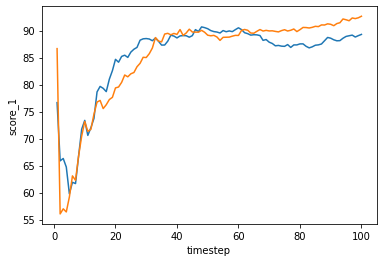

In [58]:
ds.score_1.sel(provider=slice(0, 2)).mean(['run', 'provider']).plot()
ds.score_1.sel(provider=slice(2, 4)).mean(['run', 'provider']).plot()

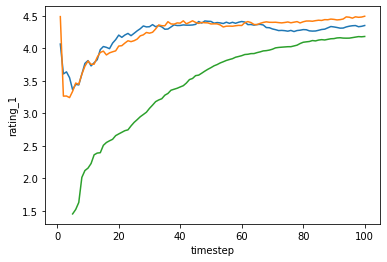

In [59]:
ds.rating_1.sel(provider=slice(0, 2)).mean(['run', 'provider']).plot()
ds.rating_1.sel(provider=slice(2, 4)).mean(['run', 'provider']).plot()
ds.rating_1.sel(provider=slice(10, 20)).mean(['run', 'provider']).plot()

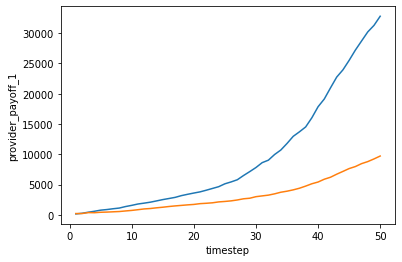

In [42]:
ds.provider_payoff_1.sel(provider=slice(0, 2)).mean(['run', 'provider']).plot()
ds.provider_payoff_1.sel(provider=slice(2, 100)).mean(['run', 'provider']).plot()

## Analysis

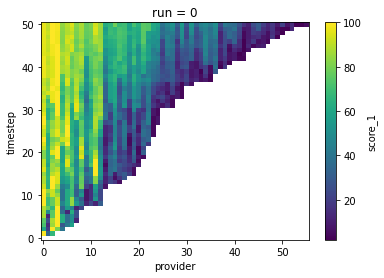

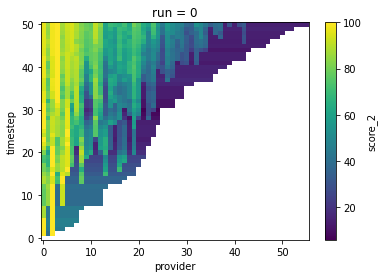

In [7]:
ds.score_1.sel(run=0).plot()
plt.show()

ds.score_2.sel(run=0).plot()
plt.show()

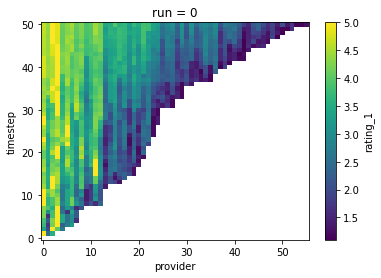

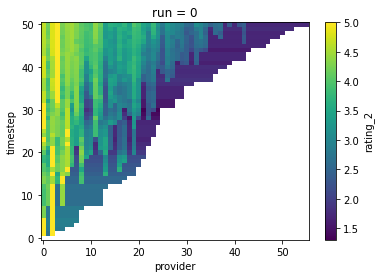

In [8]:
ds.rating_1.sel(run=0).plot()
plt.show()

ds.rating_2.sel(run=0).plot()
plt.show()

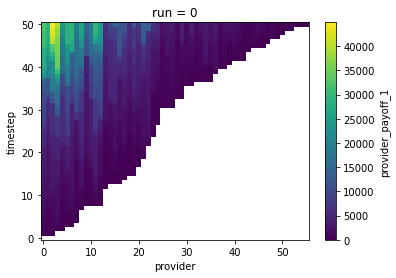

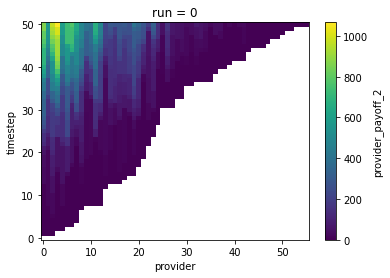

In [9]:
ds.provider_payoff_1.sel(run=0).plot()
plt.show()

ds.provider_payoff_2.sel(run=0).plot()
plt.show()

In [10]:
fig_df = ds.to_dataframe().reset_index()


fig = px.scatter(fig_df,
x='timestep',
y='provider',
color='rating_1',
facet_col='run')
fig.show()